In [1]:
using Pkg
Pkg.activate("env")
Pkg.instantiate()
include("utils.jl")

  Activating project at `~/Library/CloudStorage/OneDrive-UCB-O365/dissertation/high-order-kuramoto/env`


Threads: 8


rewire_3D_Ω (generic function with 1 method)

In [2]:
using Random 
using Distributions
using Plots
using Statistics
using LinearAlgebra
using JLD2
using Base.Threads
using Roots
using Combinatorics

In [98]:
n = 2000
lwbd = 30
upbd = 70

A2, degree2, target = create_L_CL_UN(n, lwbd, upbd)
A3, degree3 = create_3D(n, target)

kp2 = Float64(mean(BigFloat.(degree2) .^ 2))
kp = Float64(mean(BigFloat.(degree2)))

K2Crit_mean = K2C * kp / kp2
println("K2Crit mean field: ", K2Crit_mean)

kpp = Float64(mean(BigFloat.(degree3)))
kpp2 = Float64(mean(BigFloat.(degree3) .^ 2))
kpp3 = Float64(mean(BigFloat.(degree3) .^ 3))
kpp4 = Float64(mean(BigFloat.(degree3) .^ 4))
K3Crit_mean = kpp4 * kpp^2 / (kpp2^2 * kpp3)
println("K3c mean field: ", K3Crit_mean)

params = (n, degree2, A2, degree3, A3)
sumdeg2 = sum(degree2)

θ = rand(Uniform(0, 2π), n)
ω = zeros(Float64, n)
for i in 1:n 
    ω[i] = tan(π*(2i-n-1)/(n+1))
end

Adj2 = zeros(Int32, n, n)
for i in 1:n
    for j in 1:degree2[i]
        Adj2[i, A2[i][j]] = 1
    end
end

λ, Un = Un_gen(n, degree2, A2)
den = den_cal(n, degree3, A3, Un)

K2Crit = 2.0/λ
println("K2Crit: ", K2Crit)
K3Crit = λ * sum(Un .^ 4)/den * K2Crit
println("K3Crit: ", K3Crit)

k2min = 0.0 * K2Crit
k2max = 2.0 * K2Crit
dk = 0.1 * K2Crit
k2 = k2min
k3 = 0.5 * K3Crit 

K2Crit mean field: 0.03707909163546362
K3c mean field: 0.020745969431716763
K2Crit: 0.03705673254787982
K3Crit: 0.022547158692848884


0.011273579346424442

In [99]:
dt = 0.01
Tend = 100.0
time_steps = Int(Tend/dt)

10000

In [147]:
k2 = 3.0 * K2Crit
θs = zeros(time_steps, n)
Ravg = 0.0
for t in 1:time_steps
    Hn, Ψn, Rn = cal_order_param(k2, k3, θ, params)
    θ = Heun_step(θ, ω, dt, Hn, Ψn, Rn, k2, k3, params)
    θs[t, :] = θ
    R = 0.0 + 0.0*1im
    for i in 1:n
        R += Rn[i]
    end
    R /= sumdeg2;
    R = abs(R)

    if t > 0.5 * time_steps
        Ravg = (t - 0.5 * time_steps) * Ravg/(t - 0.5 * time_steps + 1) + R/ (t - 0.5 * time_steps + 1)
    end
end

In [148]:
init_valt = 5e-3
init_valf = 5e-3
println("Ravg: ", Ravg)
Rt = R1_th_sum(init_valt, k2 ,k3, ω, params)
println("Rtat: ", Rt)
Rf = R1_th_Int(init_valf, k2, k3, params)
println("Rfda: ", Rf)

Ravg: 0.8237326951091305
Rtat: 0.8281150281658806
Rfda: 0.8296121451568933


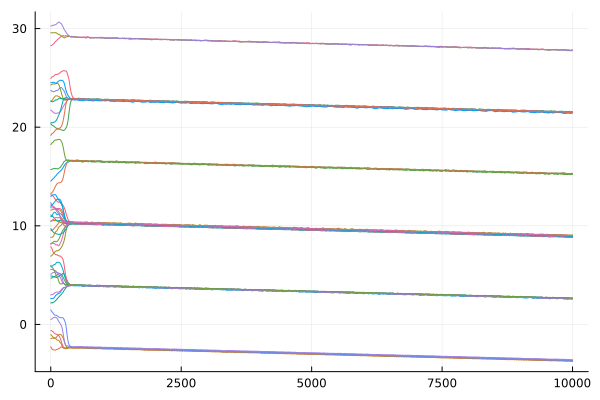

In [159]:
ts = 1:time_steps
plot(ts[1:end], θs[1:end, 1:50],legend=false)

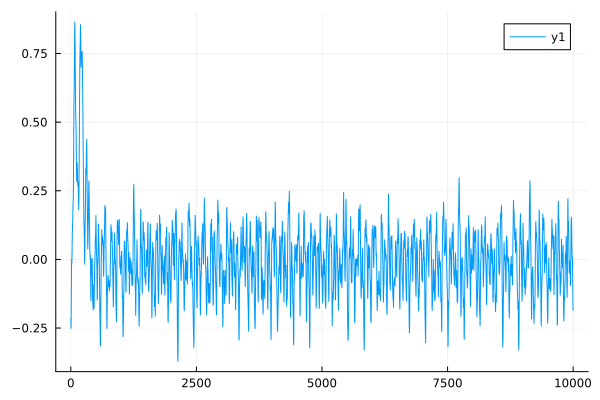

In [150]:
θdot = diff(θs, dims=1) / dt
plot(ts[1:end-1], θdot[:, 1])

In [154]:
ψs = zeros(time_steps, n)
ψp = zeros(time_steps, n)
for i in 1:time_steps
    Hn, Ψn, Rn = cal_order_param(k2, k3, θs[i,:], params)
    ψs[i, :] = Ψn
    Hn, Ψn, Rn = cal_order_param(k2, k3, θp[i,:], params)
    ψp[i, :] = Ψn  
end

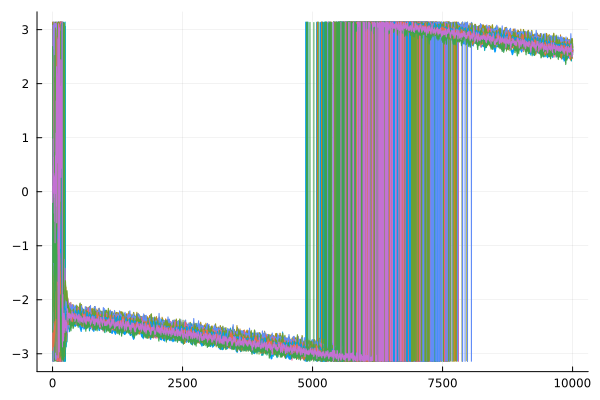

In [158]:
plot(ts, ψs[:, 1:100],legend=false)

# plot!(ts[10000:end], ψp[10000:end, 1:2],legend=false,c=:red)

In [ ]:
ψdot = diff(ψs, dims=1) / dt
Ωs = mean(ψdot[5000:end, :], dims=1)[:]
θp = zeros(time_steps, n)
for i in 1:time_steps
    θp[i, :] .= θs[i, :] .- Ωs .* dt
end

ψp = zeros(time_steps, n)
for i in 1:time_steps
    Hn, Ψn, Rn = cal_order_param(k2, k3, θp[i,:], params)
    ψp[i, :] = Ψn  
end

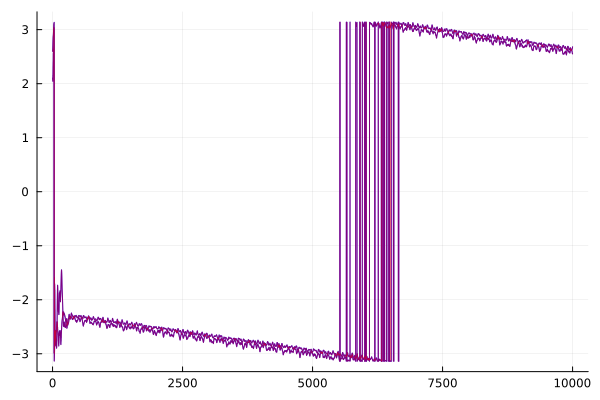

In [166]:
plot(ts, ψs[:, 1:2],legend=false,c=:blue)
plot!(ts, ψp[:, 1:2],legend=false,c=:red,opacity=0.5)

In [169]:
θs

10000×2000 Matrix{Float64}:
 2.64448  -2.27287  4.68714  5.57158  …  -4.7814   -4.0449   -1.53378
 2.64232  -2.28549  4.68699  5.5725      -4.79281  -4.04915  -1.52845
 2.64012  -2.29806  4.68709  5.57365     -4.80488  -4.05314  -1.52339
 2.6378   -2.31052  4.68738  5.57457     -4.8177   -4.05691  -1.51859
 2.63536  -2.3228   4.68779  5.57505     -4.83049  -4.06054  -1.51395
 2.63285  -2.3348   4.6883   5.57562  …  -4.84225  -4.06408  -1.50943
 2.63053  -2.34644  4.68888  5.57623     -4.85272  -4.06755  -1.5051
 2.62831  -2.35767  4.68949  5.57652     -4.86203  -4.0709   -1.50103
 2.62619  -2.36847  4.69011  5.57653     -4.87037  -4.07403  -1.49717
 2.62448  -2.37886  4.69076  5.57636     -4.87844  -4.07685  -1.49346
 ⋮                                    ⋱                      
 2.61188  -3.64939  2.63985  2.6512      -9.93269  -3.5701   -3.59599
 2.61081  -3.6487   2.64019  2.65521     -9.93215  -3.57341  -3.59699
 2.60956  -3.64779  2.64033  2.65907     -9.93218  -3.57663  -3.5982
 2

In [170]:
θp

10000×2000 Matrix{Float64}:
 2.64337  -2.274    4.68604  5.57046  …  -4.78253  -4.046    -1.53489
 2.64121  -2.28662  4.68588  5.57137     -4.79393  -4.05024  -1.52957
 2.63901  -2.29919  4.68598  5.57253     -4.80601  -4.05423  -1.5245
 2.63669  -2.31165  4.68627  5.57345     -4.81882  -4.05801  -1.5197
 2.63425  -2.32393  4.68669  5.57392     -4.83162  -4.06163  -1.51507
 2.63174  -2.33593  4.6872   5.5745   …  -4.84337  -4.06517  -1.51054
 2.62942  -2.34757  4.68777  5.57511     -4.85384  -4.06864  -1.50621
 2.6272   -2.35879  4.68838  5.5754      -4.86315  -4.07199  -1.50214
 2.62509  -2.3696   4.68901  5.5754      -4.87149  -4.07512  -1.49828
 2.62337  -2.37999  4.68965  5.57524     -4.87956  -4.07794  -1.49457
 ⋮                                    ⋱                      
 2.61078  -3.65052  2.63874  2.65008     -9.93382  -3.57119  -3.59711
 2.6097   -3.64983  2.63908  2.65409     -9.93328  -3.5745   -3.5981
 2.60845  -3.64892  2.63922  2.65794     -9.9333   -3.57773  -3.59931
 2.

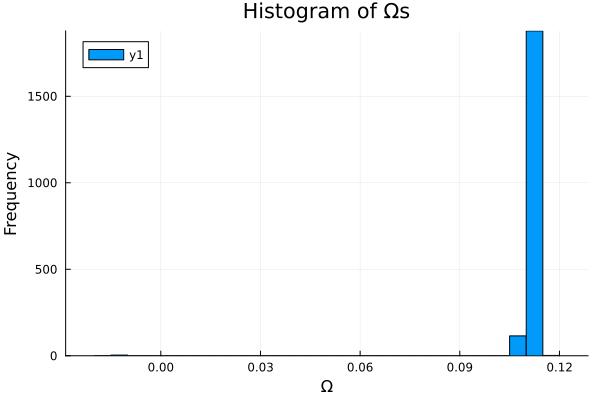

In [167]:
histogram(Ωs, bins=30, xlabel="Ω", ylabel="Frequency", title="Histogram of Ωs")